In [1]:
DATA_DIR = '/storage/groups/ml01/workspace/louis.kuemmerle/projects/A1/data2/'
DATA_VERSION = 'april21'
SHAM = True

########################################################################################
sham_str = '_wSham' if SHAM else ''
RESULTS_FILE_PATH = f'./02b_fine_annotations/final_annotations{sham_str}.csv'

# Imports

In [2]:
import os
import pandas as pd

import numpy as np
import itertools
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

import scanpy as sc
import anndata as ann
import scvelo as scv
import cellrank as cr

import scipy as sci
from scipy import sparse
from scipy.sparse import csr_matrix, issparse
from matplotlib import rcParams
from matplotlib import colors

sc.settings.verbosity = 3
sc.logging.print_header()#print_versions()
print(f"scvelo=={scv.__version__}")
print(f"cellrank=={cr.__version__}")

rcParams['figure.figsize']= (10,10)

scanpy==1.6.1 anndata==0.7.5 umap==0.4.6 numpy==1.19.5 scipy==1.6.0 pandas==1.2.0 scikit-learn==0.24.0 statsmodels==0.12.1 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3
scvelo==0.2.2
cellrank==1.1.0


# Map new annotations 
to `adata.obs["level1"]` (coarse) and `adata.obs["level2"]` (fine)

Load adata with preliminary annotations in `adata.obs['cell_types']`

In [3]:
adata = sc.read(DATA_DIR+f'cellxgene_{DATA_VERSION}{sham_str}.h5ad') 

In [4]:
fine_ann = pd.read_csv(RESULTS_FILE_PATH,index_col=0)
for key in ['level2','level1']:
    adata.obs[key] = fine_ann[key]

# Compute umaps for groups of fine annotations

In [5]:
def plot_subset_umap(adata,group,**kwargs):
    a = adata[~np.isnan(adata.obsm[f'X_umap_{group}']).any(axis=1)]
    sc.pl.embedding(basis=f'X_umap_{group}', adata=a,**kwargs)

def clean_for_umap(adata,verbose=True):
    if 'neighbors' in adata.uns: 
        del adata.uns['neighbors']
        if verbose: print("Deleted adata.uns['neighbors']")
    if 'pca' in adata.uns: 
        del adata.uns['pca']
        if verbose: print("Deleted adata.uns['pca']")
    if 'X_pca' in adata.obsm: 
        del adata.obsm['X_pca']
        if verbose: print("Deleted adata.obsm['X_pca']")
    if 'X_umap' in adata.obsm: 
        del adata.obsm['X_umap']
        if verbose: print("Deleted adata.obsm['X_umap']")
    if 'PCs' in adata.varm: 
        del adata.varm['PCs']
        if verbose: print("Deleted adata.varm['PCs']")
    if 'connectivities' in adata.obsp: 
        del adata.obsp['connectivities']
        if verbose: print("Deleted adata.obsp['connectivities']")
    if 'distances' in adata.obsp: 
        del adata.obsp['distances']
        if verbose: print("Deleted adata.obsp['distances']")

... storing 'level2' as categorical
... storing 'level1' as categorical


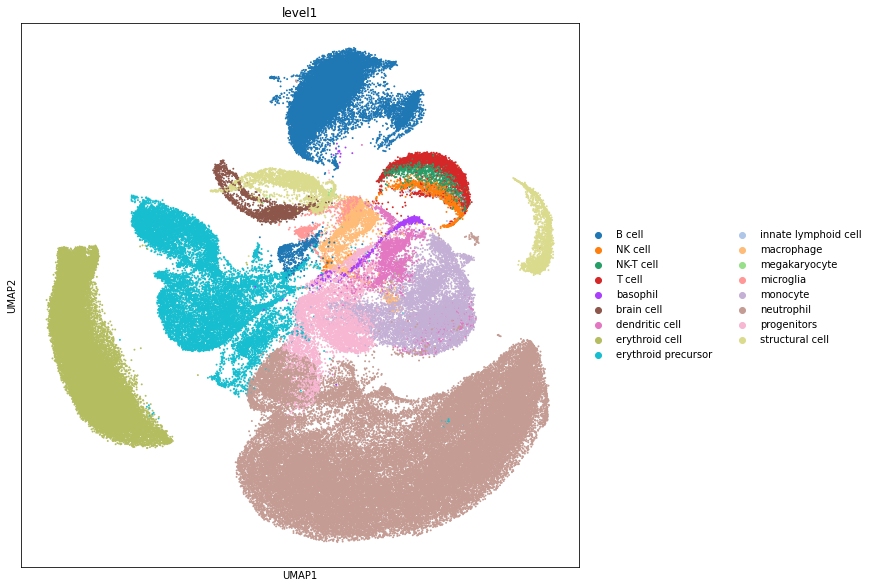

In [6]:
sc.pl.umap(adata,color=['level1'],size=15,ncols=1)

In [7]:
umap_groups = {
    'NKT' : ['T cell','NK cell','NK-T cell',],
    'B cells' : ['B cell',],
    'basophil' : ['basophil',],
    'DC' : ['dendritic cell',],
    'erythroid' : ['erythroid cell','erythroid precursor',],
    'macrophage' : ['macrophage', 'microglia',],
    'monocytes' : ['monocyte',],
    'progenitors' : ['progenitors',],
    'neutrophils' : ['neutrophil',],   
    'structural cells' : ['structural cell',],
    'brain cells' : ['brain cell'],
    'other' : ['innate lymphoid cell','megakaryocyte',]    
}  

adata.uns['umap_groups'] = umap_groups

sc.settings.verbosity = 0
from tqdm.notebook import tqdm
for group, cts in tqdm(umap_groups.items()): # {g:cs for g,cs in umap_groups.items() if f'X_umap_{g}' not in adata.obsm}
    a = adata[adata.obs['level1'].isin(cts)].copy()
    clean_for_umap(a,verbose=False)
    sc.tl.pca(a)
    sc.pp.neighbors(a)
    sc.tl.umap(a)
    # assign umap coordinates to adata
    adata.obsm[f'X_umap_{group}'] = np.empty((adata.n_obs,2,))
    adata.obsm[f'X_umap_{group}'][:] = np.nan
    obs = [(o in a.obs_names) for o in adata.obs_names]
    obs_names = adata[obs].obs_names
    adata.obsm[f'X_umap_{group}'][obs,:] = a[obs_names].obsm['X_umap']
sc.settings.verbosity = 3

  0%|          | 0/12 [00:00<?, ?it/s]

# Celltype orders and color maps

In [11]:
cts_level1 = {
    #progenitors    
    'progenitors'          :'#ff9896',
    #neutrophils    
    'neutrophil'           :'#279e68',
    #monocytes    
    'monocyte'             :'#98df8a', 
    #B cells    
    'B cell'               :'#1f77b4',
    #NK and T cells    
    'T cell'               :'#FFBB78',
    'NK cell'              :'#e8d611',
    'NK-T cell'            :'#084a21',    
    #dendritic cells    
    'dendritic cell'       :'#17becf',    
    #macrophages
    'macrophage'           :'#9E72FF',
    'microglia'            :'#3d0a61',    
    #erythroid cells    
    'erythroid precursor'  :'#B67A6E',
    'erythroid cell'       :'#8c564b',
    #basophil
    'basophil'             :'#9127E3',
    #structural cells
    'structural cell'      :'#e86711',
    #brain cells
    'brain cell'           :'#FFE4B2',
    #others          
    'megakaryocyte'        :'#FFD8FF',
    'innate lymphoid cell' :'#aec7e8',
}

cts_level2 = {
    #progenitors
    'hematopoietic stem cell'              : '#FFCBC9',
    'common myeloid progenitor'            : '#E67F7D',
    'granulocyte-monocyte progenitor'      : '#B34C4A',
    'neutrophil-primed GMP'                : '#bdffff',#'#D9FFFF',
    'monocyte-primed GMP'                  : '#bbffa8',#'#CBFFBD',
    'erythroid progenitor'                 : '#ffe0cc',#'#FFEFE4',
    'macrophage-DC progenitor (MDP)'       : '#6dc74c',
    'common DC progenitor (CDP)'           : '#81c47b',
    #neutrophils
    'pro neutrophil'                       : '#85ffde',#'#A6FFE7',
    'pre neutrophil'                       : '#74EBB5',
    'immature neutrophil'                  : '#279e68',
    'mature neutrophil'                    : '#006B35',
    #monocytes
    'monocyte progenitor'                  : '#98DF8A',        
    'classical monocyte'                   : '#D08ADE',
    'non-classical monocyte'               : '#8AC2DE',
    #B cells
    'pro B cell'                           : '#B8FFFF',
    'pre B cell'                           : '#85DDFF',
    'immature B cell'                      : '#52AAE7',
    'mature B cell'                        : '#1f77b4',
    'plasma cell'                          : '#002B68',
    #NK and T cells
    'Cd8 T cell'                           : '#B36F2C',
    'Cd4 T cell'                           : '#FFBB78',
    'gdT cell'                             : '#662200',
    'NK-T cell'                            : '#279e68',
    'NK cell'                              : '#e8d611',
    #dendritic cells
    'plasmacytoid DC'                      : '#17becf',
    'conventional DC1'                     : '#60CF17',
    'conventional DC2'                     : '#8517CF',
    'monocyte-derived DC'                  : '#CF2917',
    'B cell-DC hybrid'                     : '#005869',
    'neutrophil-DC hybrid'                 : '#0044FF',
    #macrophages
    'perivascular macrophage'              : '#B80022',
    'monocyte-derived macrophage'          : '#0077B8',
    'microglia'                            : '#3d0a61',
    'macrophage'                           : '#9E72FF',
    'antigen-presenting macrophage'        : '#00B896',    
    #erythroid cells
    'erythroid cell'                       : '#F2BCB1',
    'erythroblast'                         : '#BF897E',    
    'erythrocyte'                          : '#8c564b',
    #basophil
    'basophil progenitor'                  : '#DE74FF',    
    'basophil'                             : '#9127E3',
    #structural cells
    'fibroblast'                           : '#D6E810',
    'dural fibroblast'                     : '#2210E8',
    'endothelial cell'                     : '#10E88E',
    'adipose-derived stromal cell'         : '#1092E8',    
    'brain-Chroid Plexus endothelial cell' : '#40bcf2',
    'meningeal-Choroid Plexus cell'        : '#e8116b',
    'Omp+ cell'                            : '#D210E8',
    'Gnb3+ cell'                           : '#e86711',    
    #brain cells
    'neuron'                               : '#B3CDFF',     
    'astrocyte'                            : '#FFB3F4',
    'oligodendrocyte'                      : '#4D9958',
    #others                                                                                               
    'megakaryocyte'                        : '#1EB279',
    'innate lymphoid cell'                 : '#a055ad',    
}


adata.obs['level1'].cat.reorder_categories([celltype for celltype in cts_level1],inplace=True)
adata.uns['level1_colors'] = [c for _,c in cts_level1.items()]
adata.obs['level2'].cat.reorder_categories([celltype for celltype in cts_level2],inplace=True)
adata.uns['level2_colors'] = [c for _,c in cts_level2.items()]

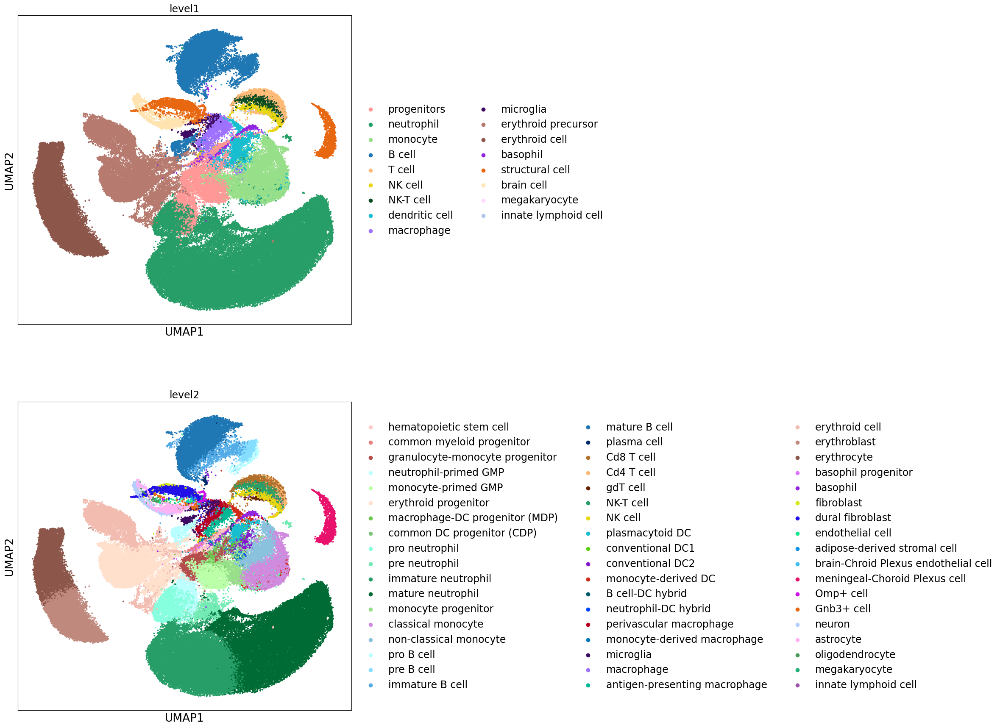

In [12]:
sc.pl.umap(adata,color=['level1','level2'],size=30,ncols=1)

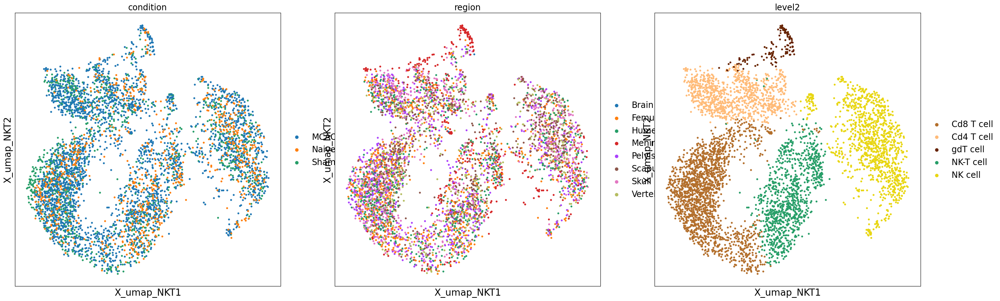

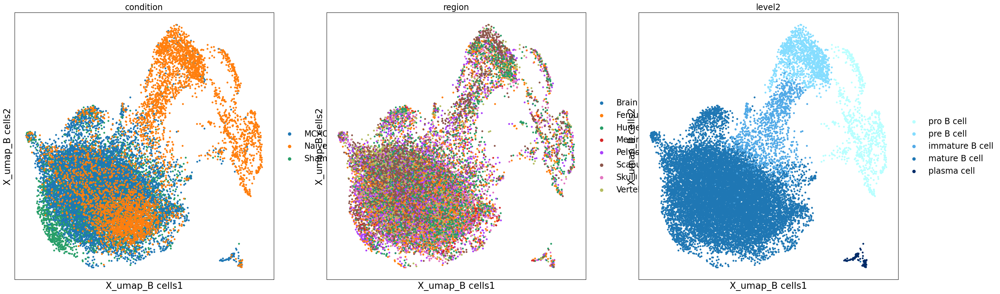

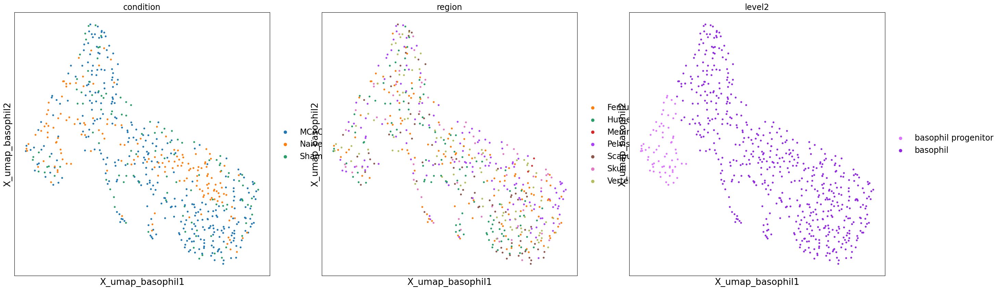

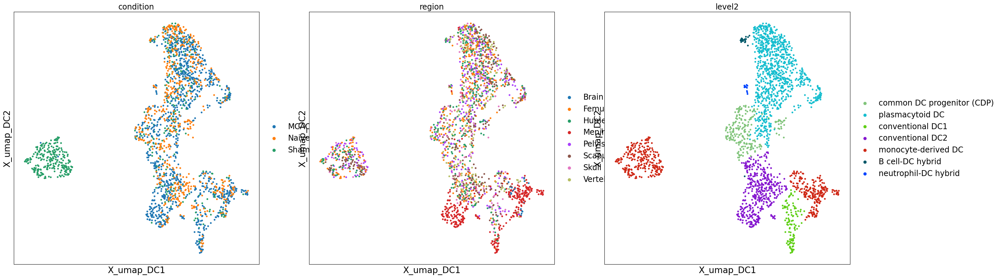

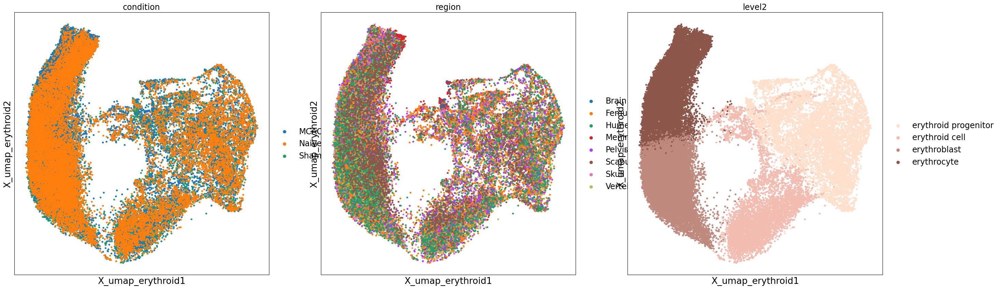

...

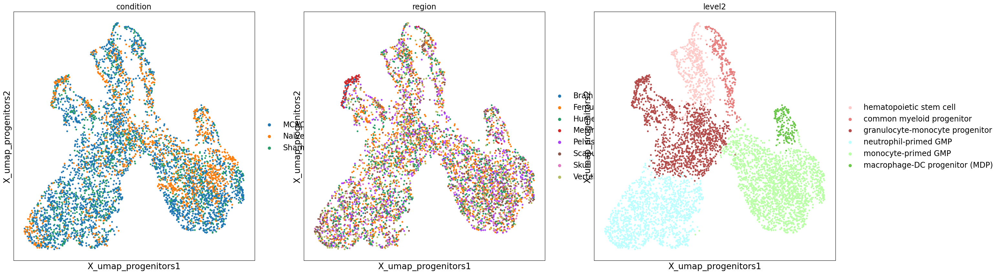

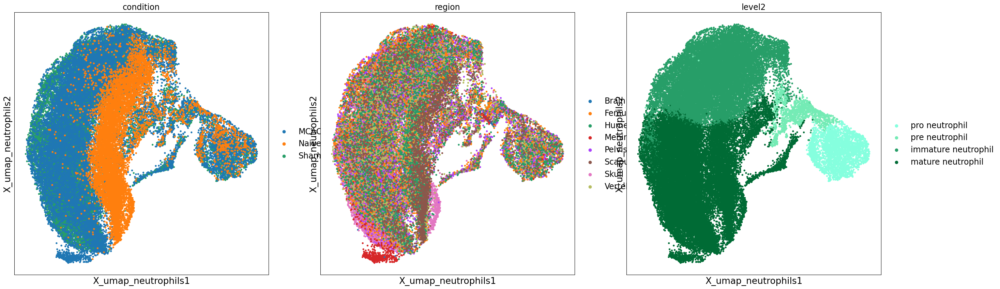

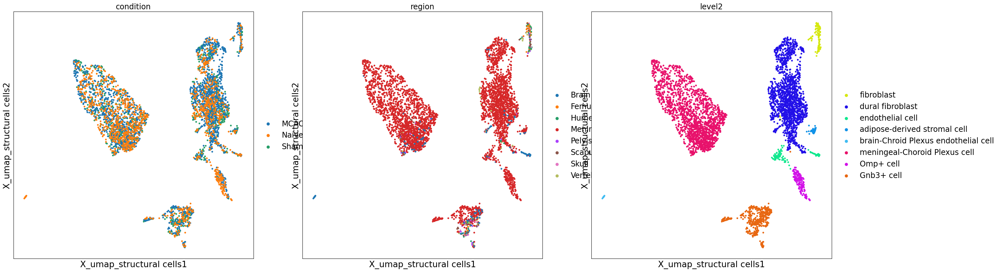

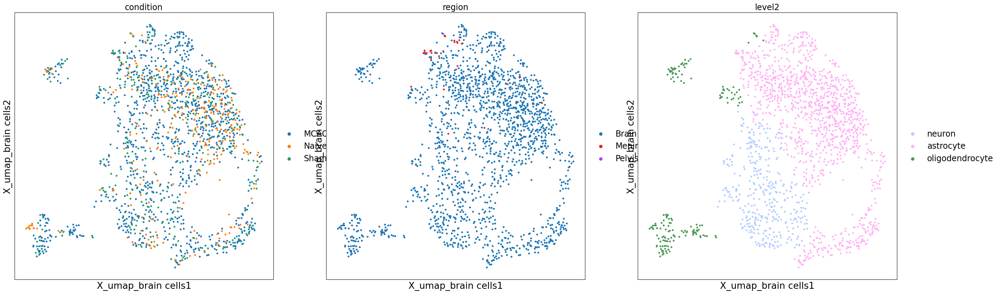

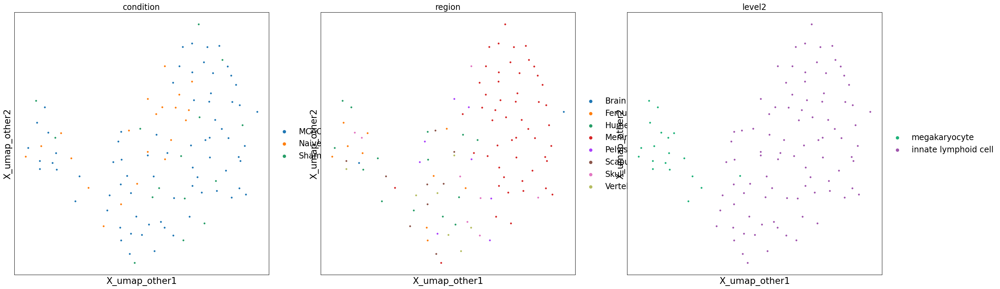

In [13]:
plt.rcParams['figure.dpi'] = 100

SMALL_SIZE = 17
MEDIUM_SIZE = 19
BIGGER_SIZE = 21

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

for group in adata.uns['umap_groups']:
    plot_subset_umap(adata,group,color=['condition','region','level2'],size=60)

In [14]:
sc.write(adata=adata, filename=DATA_DIR+f'cellxgene_{DATA_VERSION}{sham_str}_umaps.h5ad')

### Corrections
- change MDP name: (monocyte instead of macrophage)

In [3]:
def plot_subset_umap(adata,group,**kwargs):
    a = adata[~np.isnan(adata.obsm[f'X_umap_{group}']).any(axis=1)]
    sc.pl.embedding(basis=f'X_umap_{group}', adata=a,**kwargs)

In [4]:
adata = sc.read(DATA_DIR+f'cellxgene_{DATA_VERSION}{sham_str}_umaps.h5ad')

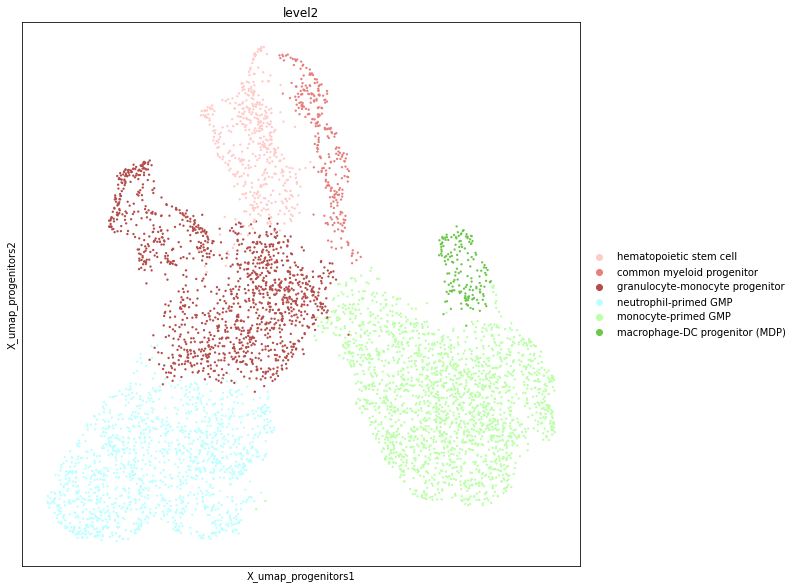

In [5]:
plot_subset_umap(adata,'progenitors',color='level2')

In [8]:
adata.obs['level2'] = adata.obs['level2'].cat.rename_categories({'macrophage-DC progenitor (MDP)': 'monocyte-DC progenitor (MDP)'})

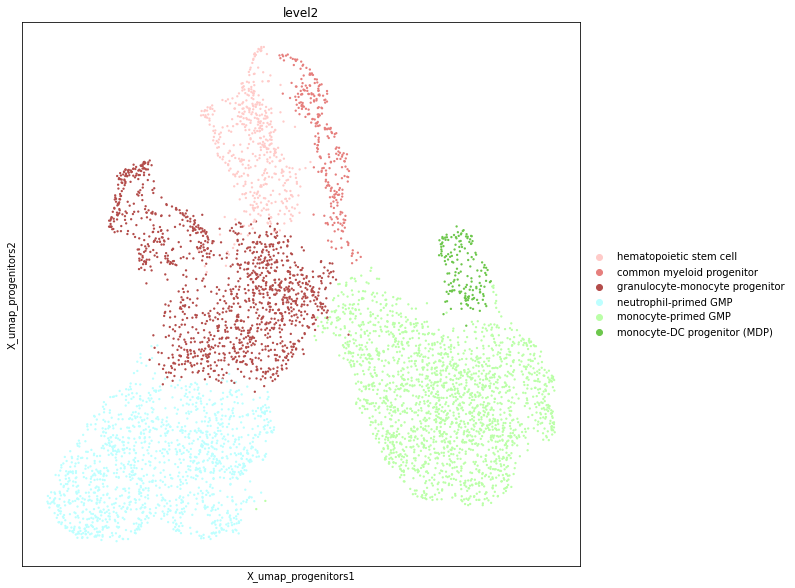

In [9]:
plot_subset_umap(adata,'progenitors',color='level2')

In [10]:
sc.write(adata=adata, filename=DATA_DIR+f'cellxgene_{DATA_VERSION}{sham_str}_umaps.h5ad')

# Save adata for Naive umaps only

In [12]:
def plot_subset_umap(adata,group,**kwargs):
    a = adata[~np.isnan(adata.obsm[f'X_umap_{group}']).any(axis=1)]
    sc.pl.embedding(basis=f'X_umap_{group}', adata=a,**kwargs)

def clean_for_umap(adata,verbose=True):
    if 'neighbors' in adata.uns: 
        del adata.uns['neighbors']
        if verbose: print("Deleted adata.uns['neighbors']")
    if 'pca' in adata.uns: 
        del adata.uns['pca']
        if verbose: print("Deleted adata.uns['pca']")
    if 'X_pca' in adata.obsm: 
        del adata.obsm['X_pca']
        if verbose: print("Deleted adata.obsm['X_pca']")
    if 'X_umap' in adata.obsm: 
        del adata.obsm['X_umap']
        if verbose: print("Deleted adata.obsm['X_umap']")
    if 'PCs' in adata.varm: 
        del adata.varm['PCs']
        if verbose: print("Deleted adata.varm['PCs']")
    if 'connectivities' in adata.obsp: 
        del adata.obsp['connectivities']
        if verbose: print("Deleted adata.obsp['connectivities']")
    if 'distances' in adata.obsp: 
        del adata.obsp['distances']
        if verbose: print("Deleted adata.obsp['distances']")

In [13]:
sc.settings.verbosity = 0

adata = sc.read(DATA_DIR+f'cellxgene_{DATA_VERSION}{sham_str}_umaps.h5ad')
adata = adata[adata.obs['condition']=='Naive'].copy()

# full set:
clean_for_umap(adata,verbose=False)
sc.tl.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)

# subsets:

umap_groups = {
    'NKT' : ['T cell','NK cell','NK-T cell',],
    'B cells' : ['B cell',],
    'basophil' : ['basophil',],
    'DC' : ['dendritic cell',],
    'erythroid' : ['erythroid cell','erythroid precursor',],
    'macrophage' : ['macrophage', 'microglia',],
    'monocytes' : ['monocyte',],
    'progenitors' : ['progenitors',],
    'neutrophils' : ['neutrophil',],   
    'structural cells' : ['structural cell',],
    'brain cells' : ['brain cell'],
    'other' : ['innate lymphoid cell','megakaryocyte',]    
}  

adata.uns['umap_groups'] = umap_groups

from tqdm.notebook import tqdm
for group, cts in tqdm(umap_groups.items()):
    a = adata[adata.obs['level1'].isin(cts)].copy()
    clean_for_umap(a,verbose=False)
    sc.tl.pca(a)
    sc.pp.neighbors(a)
    sc.tl.umap(a)
    # assign umap coordinates to adata
    adata.obsm[f'X_umap_{group}'] = np.empty((adata.n_obs,2,))
    adata.obsm[f'X_umap_{group}'][:] = np.nan
    obs = [(o in a.obs_names) for o in adata.obs_names]
    obs_names = adata[obs].obs_names
    adata.obsm[f'X_umap_{group}'][obs,:] = a[obs_names].obsm['X_umap']
sc.settings.verbosity = 3

  0%|          | 0/12 [00:00<?, ?it/s]

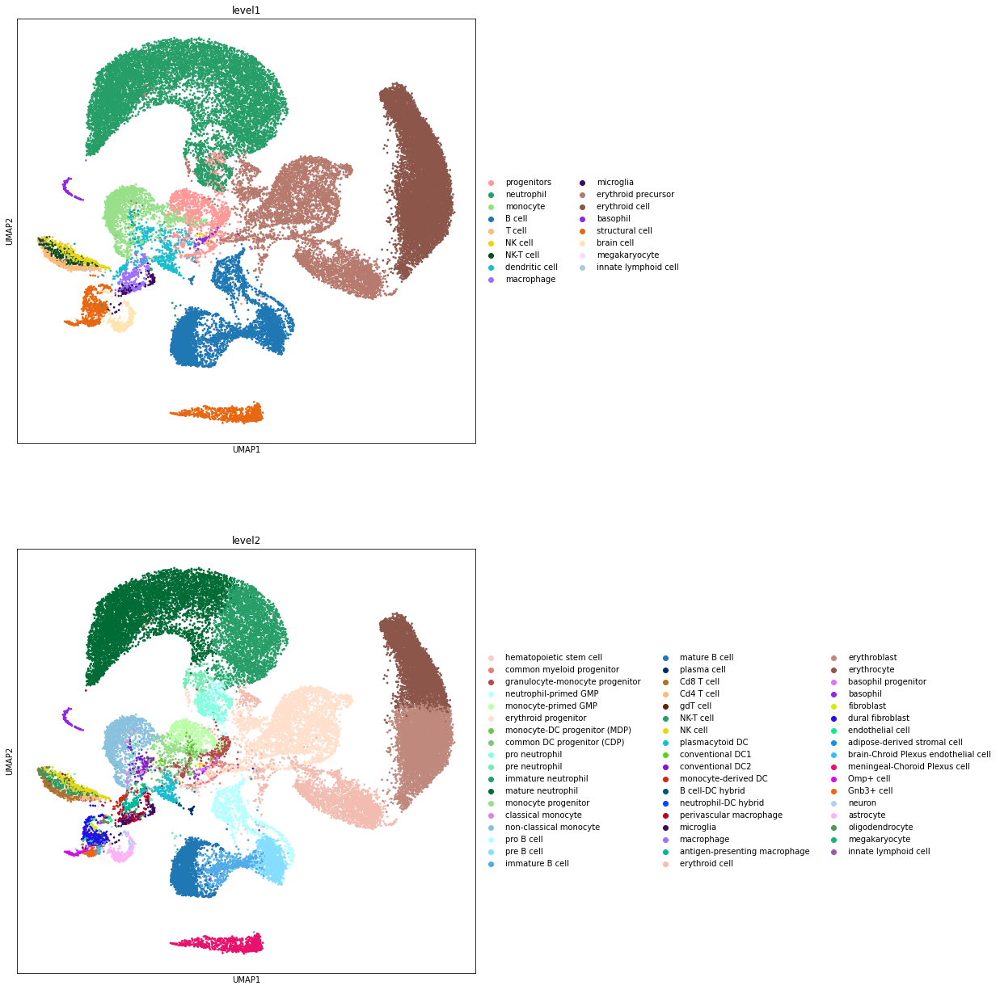

In [14]:
sc.pl.umap(adata,color=['level1','level2'],size=30,ncols=1)

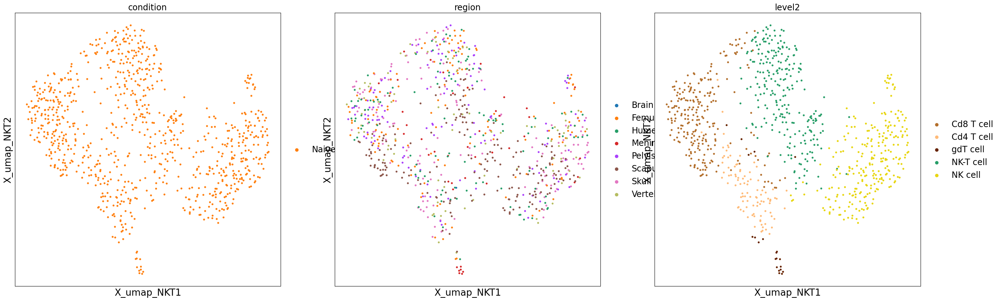

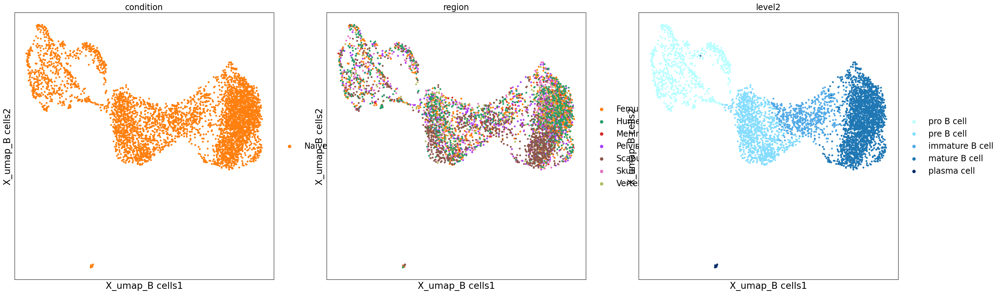

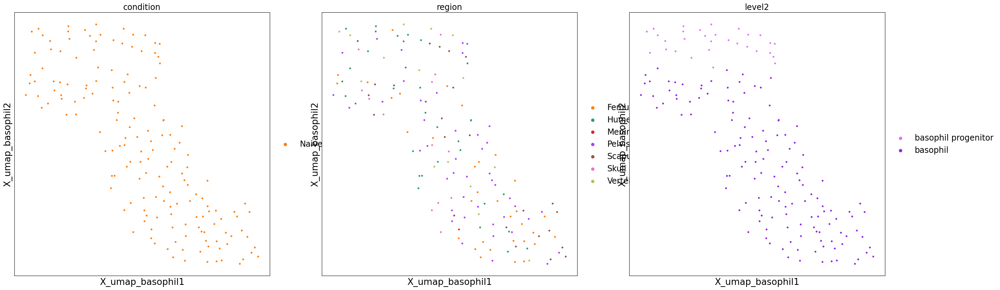

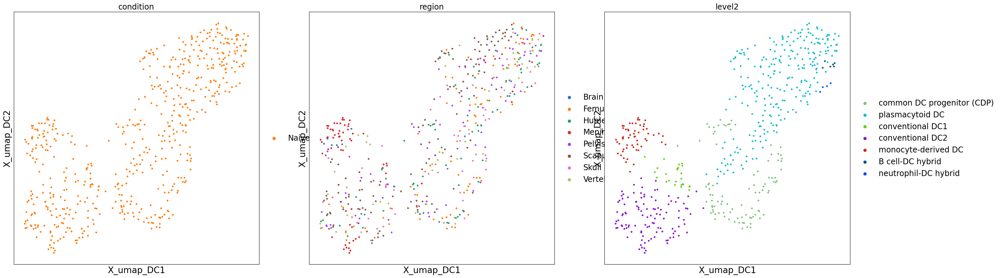

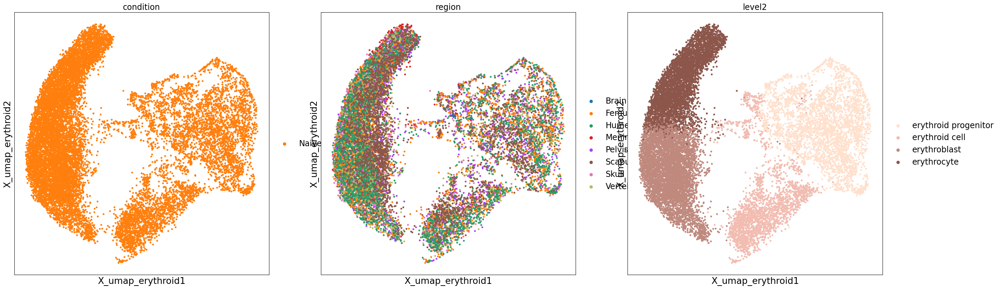

...

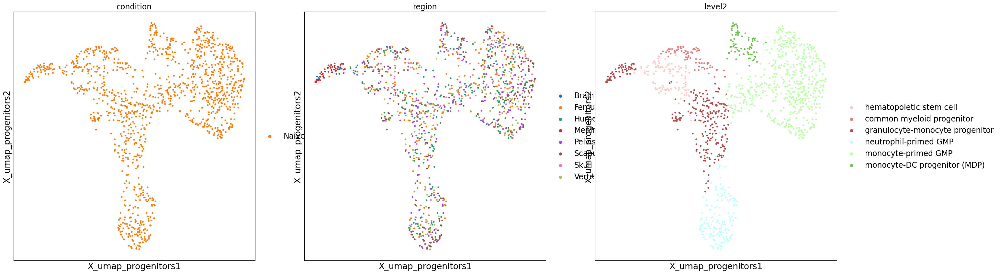

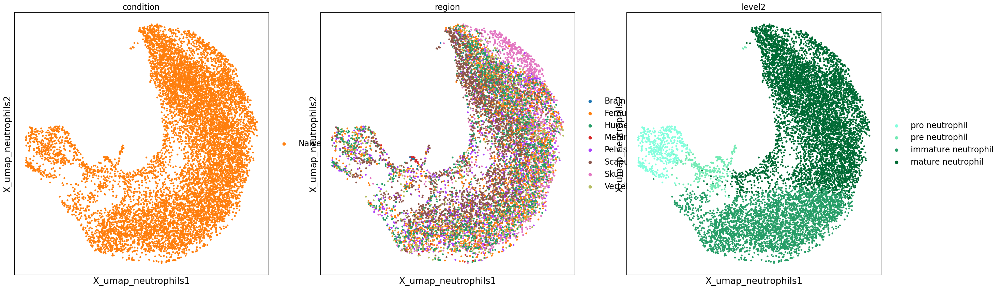

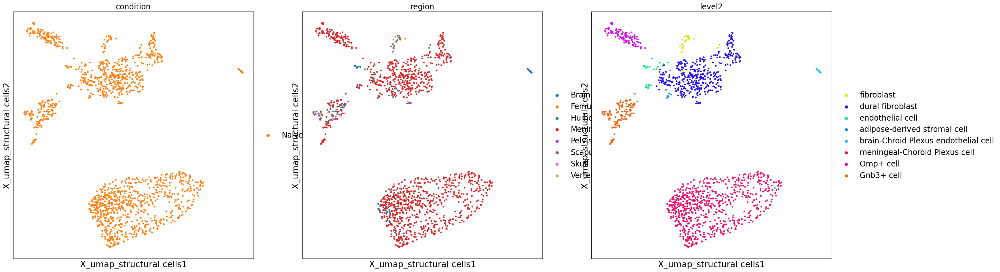

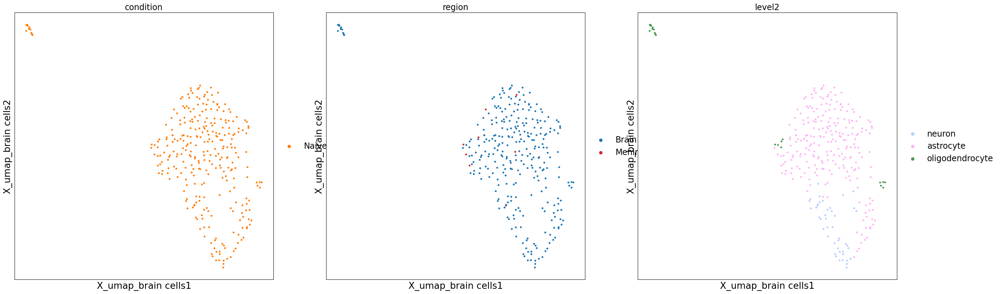

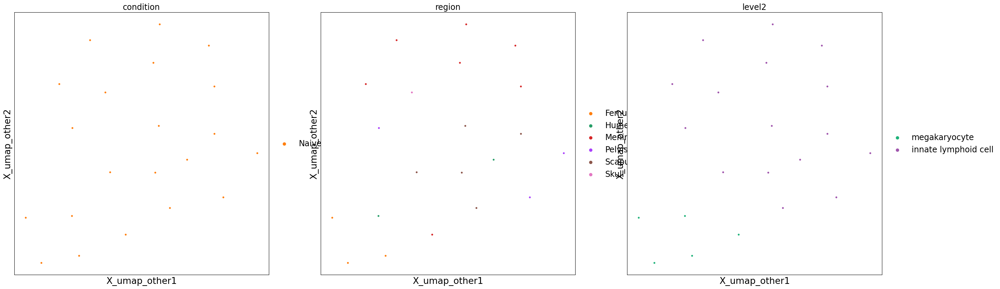

In [15]:
plt.rcParams['figure.dpi'] = 100

SMALL_SIZE = 17
MEDIUM_SIZE = 19
BIGGER_SIZE = 21

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

for group in adata.uns['umap_groups']:
    plot_subset_umap(adata,group,color=['condition','region','level2'],size=60)

In [16]:
sc.write(adata=adata, filename=DATA_DIR+f'cellxgene_{DATA_VERSION}{sham_str}_Naive_umaps.h5ad')